# adaIN version 3


### import

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import scipy.misc as misc
import os, time

### parameters

In [2]:
BATCH_SIZE = 1
IMAGE_H = 256
IMAGE_W = 256

CONTENT_WEIGHT = 1
STYLE_WEIGHT = 1e-2

COCO_PATH = '/home/minsisi/COCO_DATASET/train2014/'
DATA_NUM = 30000
EPOCH = 1
CHECK_POINT = 500
LR = 1e-4

#  28,000 style images
STYLE_PATH = '/home/minsisi/KAGGLE_STYLE_TRAIN_IMAGES/'
# STYLE_PATH = 'style_images/'
STYLE_NAME_LIST =os.listdir(STYLE_PATH)
STYLE_NUM = len(STYLE_NAME_LIST)

### new function for multi style transfer

In [3]:
def AdaIN(content,style,epsilon=1e-5):
    c_mu, c_sig_sq = tf.nn.moments(content,axes=[1,2],  keep_dims=True)
    s_mu, s_sig_sq = tf.nn.moments(style,axes=[1,2],  keep_dims=True)
    return tf.nn.batch_normalization(content, c_mu, c_sig_sq, s_mu, tf.sqrt(s_sig_sq),epsilon)

In [4]:
def calc_sty_loss(target, style):
    # target, style : relu1,2,3,4 's output f
    losses = list()
    for t,s in list(zip(target, style)):
        t_mu, t_sig_sq = tf.nn.moments(t, axes=[1,2], keep_dims=True)
        s_mu, s_sig_sq = tf.nn.moments(s, axes=[1,2], keep_dims=True)

        mu_loss = tf.reduce_sum(tf.square(t_mu - s_mu))
        sig_loss = tf.reduce_sum(tf.square(tf.sqrt(t_sig_sq) -tf.sqrt(s_sig_sq)))
        
        loss = (mu_loss+ sig_loss) / tf.cast(tf.size(mu_loss), tf.float32)
        losses.append(loss)
        
    return sum(losses)
            

### for image 

In [5]:
# # for image process
def visualize_img(x):
    return np.clip(x, 0, 255).astype('uint8')

def read_img(img_path):
    img = misc.imread(img_path)
    if not (len(img.shape) == 3 and img.shape[2] == 3):
        img = np.dstack((img,img,img))
    
    return misc.imresize(img, (IMAGE_H,IMAGE_W,3))

### tensor preprocess

In [6]:
# mean value 
def tf_rev_prosess(out_img):
    return tf.stack([ out_img[:,:,:,0] + 103.939, out_img[:,:,:,1] + 116.779,out_img[:,:,:,2] + 123.68], axis=3)

def tf_preprocess(out_img):
    return tf.stack([ out_img[:,:,:,0] - 103.939, out_img[:,:,:,1] - 116.779,out_img[:,:,:,2] - 123.68 ], axis=3)

### for vgg net

In [7]:
# for vgg network
def conv2d(x, W,padding='SAME'):
        return tf.nn.conv2d(x,W, strides=[1, 1, 1, 1], padding=padding)

def avg_pool_2x2(x):
    return tf.nn.avg_pool(x, ksize=[1, 2, 2, 1],
                        strides=[1, 2, 2, 1], padding='SAME')

def weight_tensor(shape):
    return tf.Variable(tf.truncated_normal(shape,stddev=0.1))


### vgg net

In [8]:
class vgg_19:
    def __init__(self):
        # load vgg weights
        vggW = np.load('vgg19_weights.npy')
        self.W_CONV1_1 = tf.constant(vggW[0])
        self.b_CONV1_1 = tf.constant(vggW[1])
        self.W_CONV1_2 = tf.constant(vggW[2])
        self.b_CONV1_2 = tf.constant(vggW[3])

        self.W_CONV2_1 = tf.constant(vggW[4])
        self.b_CONV2_1 = tf.constant(vggW[5])
        self.W_CONV2_2 = tf.constant(vggW[6])
        self.b_CONV2_2 = tf.constant(vggW[7])

        self.W_CONV3_1 = tf.constant(vggW[8])
        self.b_CONV3_1 = tf.constant(vggW[9])
        self.W_CONV3_2 = tf.constant(vggW[10])
        self.b_CONV3_2 = tf.constant(vggW[11])
        self.W_CONV3_3 = tf.constant(vggW[12])
        self.b_CONV3_3 = tf.constant(vggW[13])
        self.W_CONV3_4 = tf.constant(vggW[14])
        self.b_CONV3_4 = tf.constant(vggW[15])

        self.W_CONV4_1 = tf.constant(vggW[16])
        self.b_CONV4_1 = tf.constant(vggW[17])
        self.W_CONV4_2 = tf.constant(vggW[18])
        self.b_CONV4_2 = tf.constant(vggW[19])
        self.W_CONV4_3 = tf.constant(vggW[20])
        self.b_CONV4_3 = tf.constant(vggW[21])
        self.W_CONV4_4 = tf.constant(vggW[22])
        self.b_CONV4_4 = tf.constant(vggW[23])

        self.W_CONV5_1 = tf.constant(vggW[24])
        self.b_CONV5_1 = tf.constant(vggW[25])
        self.W_CONV5_2 = tf.constant(vggW[26])
        self.b_CONV5_2 = tf.constant(vggW[27])

        del(vggW)
        
    def encoder(self, vggx):
        
        h_conv1_1 = tf.nn.relu(conv2d(vggx, self.W_CONV1_1) + self.b_CONV1_1)
        h_conv1_2 = tf.nn.relu(conv2d(h_conv1_1, self.W_CONV1_2) + self.b_CONV1_2)
        h_pool1 = avg_pool_2x2(h_conv1_2)

        h_conv2_1 = tf.nn.relu(conv2d(h_pool1,   self.W_CONV2_1) + self.b_CONV2_1)
        h_conv2_2 = tf.nn.relu(conv2d(h_conv2_1, self.W_CONV2_2) + self.b_CONV2_2)
        h_pool2 = avg_pool_2x2(h_conv2_2)

        h_conv3_1 = tf.nn.relu(conv2d(h_pool2,   self.W_CONV3_1) + self.b_CONV3_1)
        h_conv3_2 = tf.nn.relu(conv2d(h_conv3_1, self.W_CONV3_2) + self.b_CONV3_2)
        h_conv3_3 = tf.nn.relu(conv2d(h_conv3_2, self.W_CONV3_3) + self.b_CONV3_3)
        h_conv3_4 = tf.nn.relu(conv2d(h_conv3_3, self.W_CONV3_4) + self.b_CONV3_4)
        h_pool3 = avg_pool_2x2(h_conv3_4)

        h_conv4_1 = tf.nn.relu(conv2d(h_pool3,   self.W_CONV4_1) + self.b_CONV4_1)
        
        return [h_conv1_1, h_conv2_1, h_conv3_1, h_conv4_1]
    
    def _conv_block(self,h,num,resize=True):
        _,s,s,ch = h.get_shape().as_list()
        new_ch = int(ch/2)
        
        for i in range(num):
            # not use pooling, use resize            
            if resize :
                h = tf.image.resize_images(h,[int(s*2), int(s*2)], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR )

            h = tf.pad(h, [[0,0],[1,1],[1,1],[0,0]], mode='REFLECT')
            h = tf.nn.relu(tf.contrib.layers.conv2d(h, new_ch, [3,3], padding='VALID'))
            
        return h
        
    def decoder(self, h):
        # decoder mirrors the encoder
        
        #relu 4
        h= self._conv_block(h, 1)
        
        # relu 3
        h = self._conv_block(h,4)
        
        # relu 2
        h = self._conv_block(h,2)
        
        # relu 1
        h = self._conv_block(h,1,resize=False)
        h = tf.pad(h, [[0,0],[1,1],[1,1],[0,0]], mode='REFLECT')
        h = tf.contrib.layers.conv2d(h, 3, [3,3], padding ='VALID')
        
        return h

In [9]:
def mirror_padding(img, kernel):
    p = (kernel-1)/2
    paddings = np.array([[0,0], [p,p], [p,p],[0,0]] ,dtype=np.int32)
    
    return tf.pad(img, paddings, mode="SYMMETRIC",name='pad')

In [10]:
# vgg net
vgg = vgg_19()

# placeholder for input images
content_images = tf.placeholder(shape=[None, IMAGE_H, IMAGE_W, 3], dtype=tf.float32)
style_images = tf.placeholder(shape=[None, IMAGE_H, IMAGE_W, 3], dtype=tf.float32)

# preprocess for vgg encoder
cont_imgs = tf_preprocess(content_images)
sty_imgs = tf_preprocess(style_images)

# get features
cont_features = vgg.encoder(cont_imgs)
sty_features = vgg.encoder(sty_imgs)

# Adaptive IN
t = AdaIN(cont_features[-1], sty_features[-1])

# decoder
generated_img = vgg.decoder(t)

# preprocess for vgg encoder
g_imgs = tf_preprocess(generated_img)
g_enc = vgg.encoder(g_imgs)

# loss
cont_loss = tf.reduce_sum(tf.square(t-g_enc[-1] )) / tf.cast(tf.size(t), tf.float32)
sty_loss = calc_sty_loss(g_enc, sty_features)

cont_loss = CONTENT_WEIGHT*cont_loss
sty_loss = STYLE_WEIGHT*sty_loss

total_loss = cont_loss +sty_loss

# optimizer
train_step  = tf.train.AdamOptimizer(LR).minimize(total_loss)

step 0 ,time : 0.158835
total loss : 4.247467e+05, content loss : 1.401904e+05, style loss : 2.845563e+05


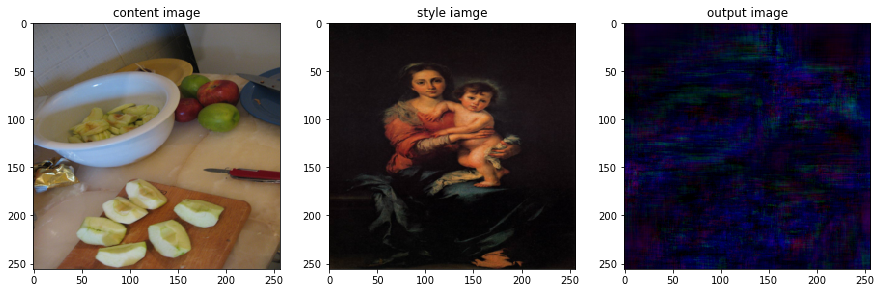

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 500 ,time : 350.746
total loss : 2.653000e+05, content loss : 8.980259e+04, style loss : 1.754974e+05


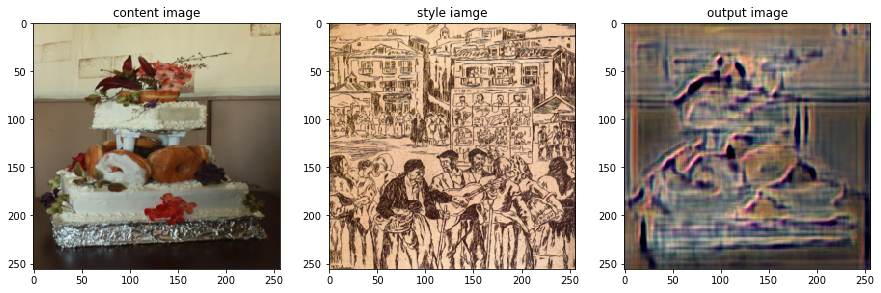

step 1000 ,time : 335.893
total loss : 2.337030e+05, content loss : 6.541107e+04, style loss : 1.682919e+05


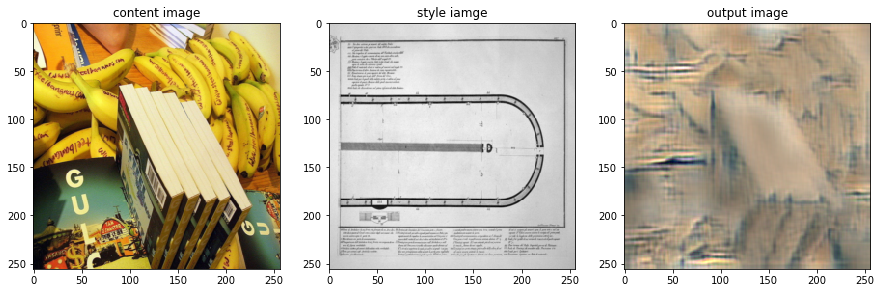

step 1500 ,time : 336.389
total loss : 5.568251e+04, content loss : 3.046609e+04, style loss : 2.521642e+04


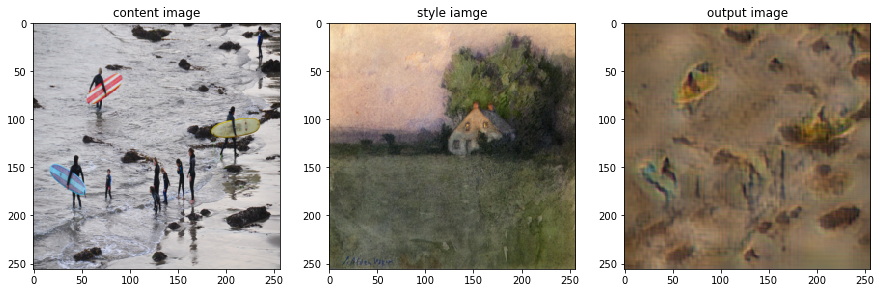

step 2000 ,time : 340.355
total loss : 9.365584e+04, content loss : 4.340964e+04, style loss : 5.024620e+04


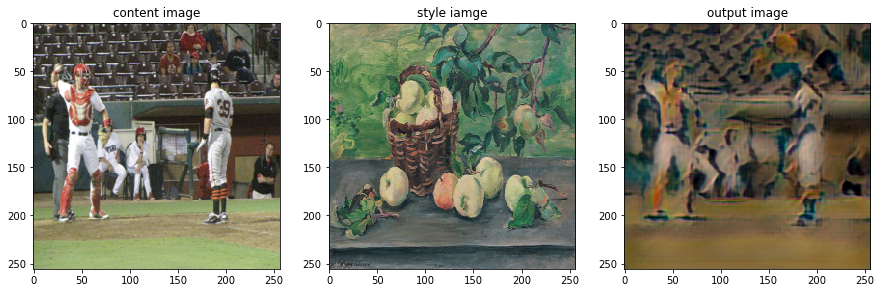

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 2500 ,time : 336.315
total loss : 1.635651e+05, content loss : 9.258223e+04, style loss : 7.098288e+04


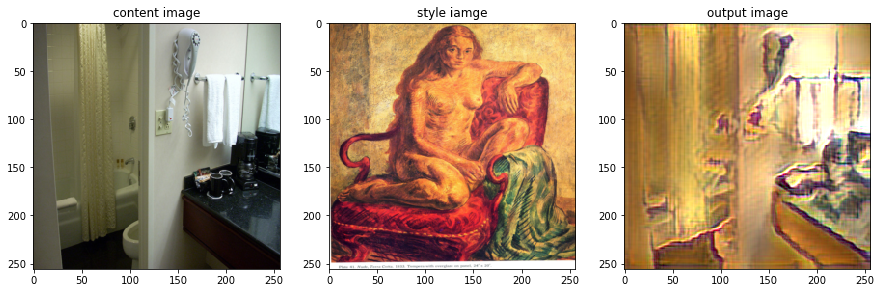

step 3000 ,time : 334.075
total loss : 5.283309e+04, content loss : 3.393774e+04, style loss : 1.889536e+04


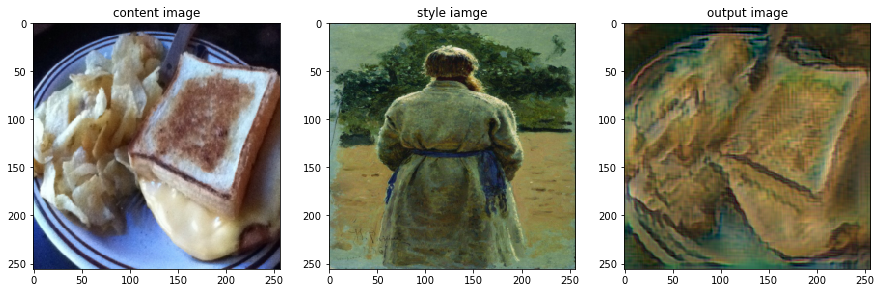

step 3500 ,time : 333.809
total loss : 2.032844e+05, content loss : 7.734521e+04, style loss : 1.259392e+05


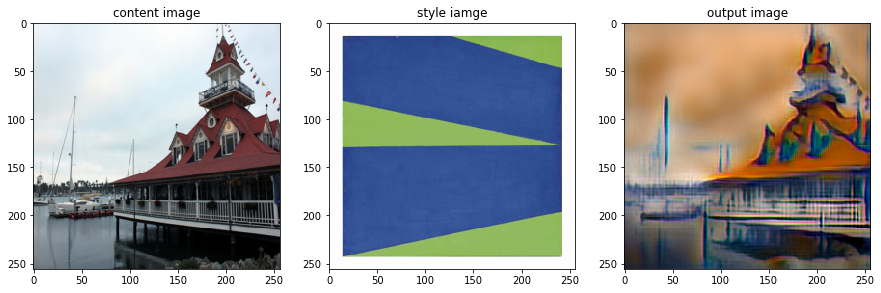

step 4000 ,time : 340.717
total loss : 7.811094e+04, content loss : 3.852748e+04, style loss : 3.958346e+04


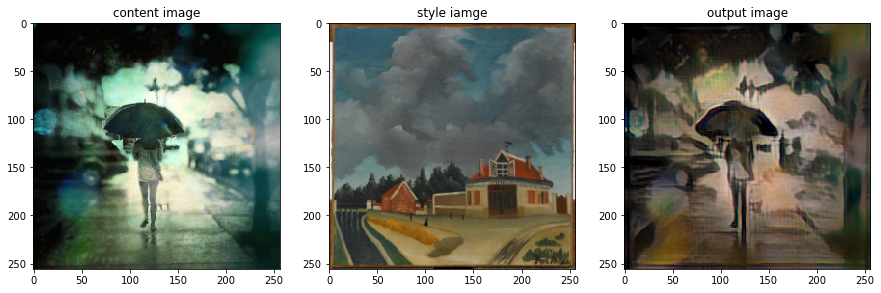

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 4500 ,time : 334.35
total loss : 1.541681e+05, content loss : 6.089944e+04, style loss : 9.326865e+04


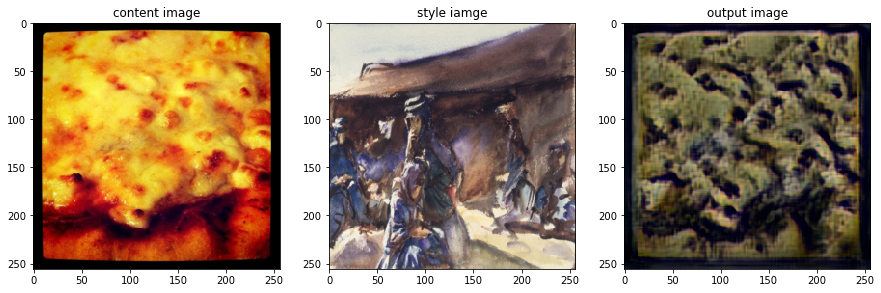

step 5000 ,time : 335.888
total loss : 8.643558e+04, content loss : 3.654999e+04, style loss : 4.988559e+04


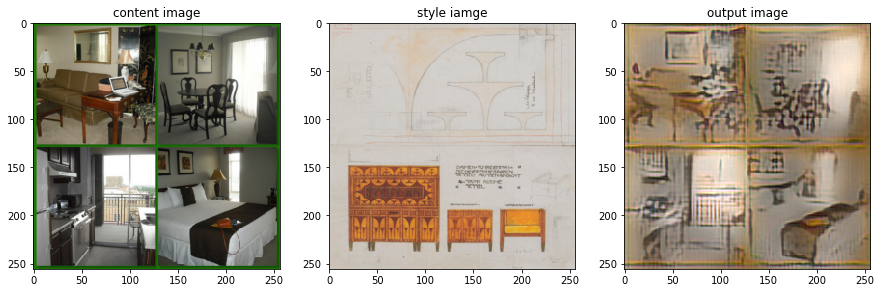

step 5500 ,time : 332.519
total loss : 4.792365e+04, content loss : 3.170333e+04, style loss : 1.622032e+04


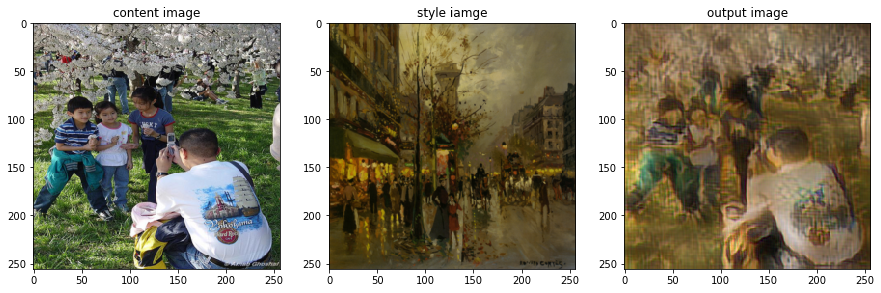

step 6000 ,time : 334.919
total loss : 5.615130e+04, content loss : 3.370793e+04, style loss : 2.244337e+04


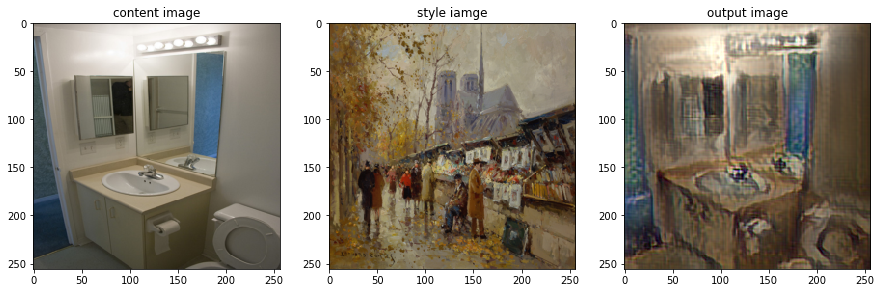

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 6500 ,time : 334.117
total loss : 4.376733e+04, content loss : 2.341082e+04, style loss : 2.035651e+04


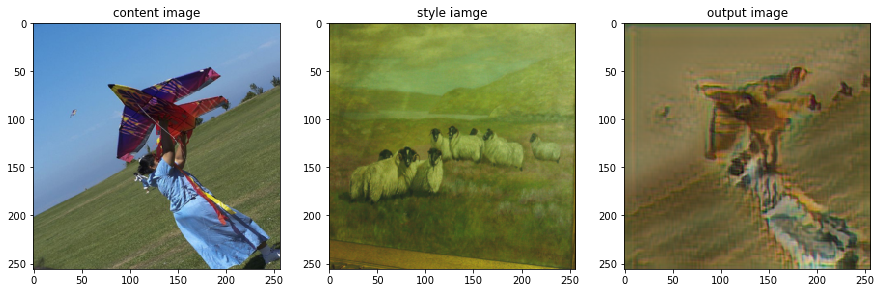

step 7000 ,time : 336.026
total loss : 8.542431e+04, content loss : 3.776552e+04, style loss : 4.765879e+04


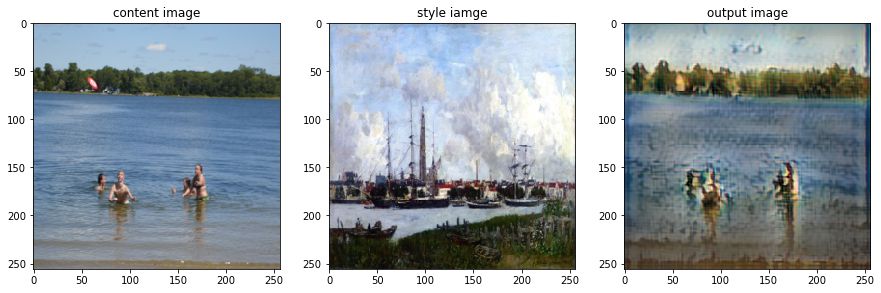

step 7500 ,time : 334.746
total loss : 7.798978e+04, content loss : 4.922936e+04, style loss : 2.876043e+04


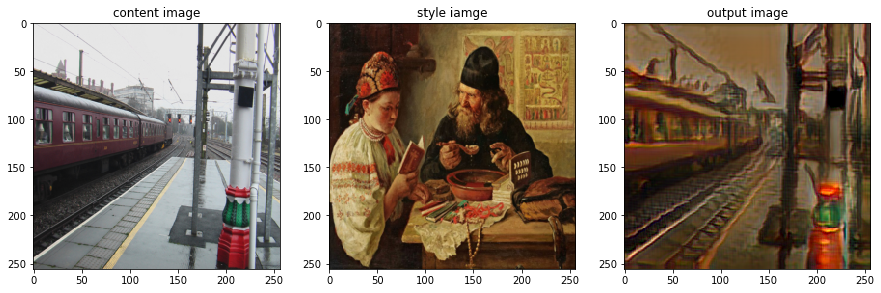

step 8000 ,time : 336.164
total loss : 1.437391e+05, content loss : 7.910960e+04, style loss : 6.462947e+04


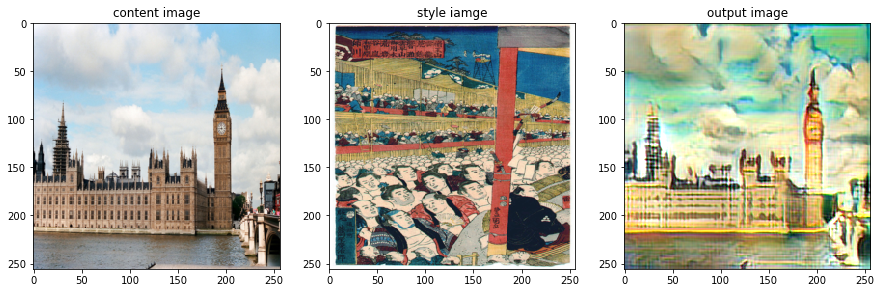

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 8500 ,time : 338.421
total loss : 8.931298e+04, content loss : 3.941139e+04, style loss : 4.990159e+04


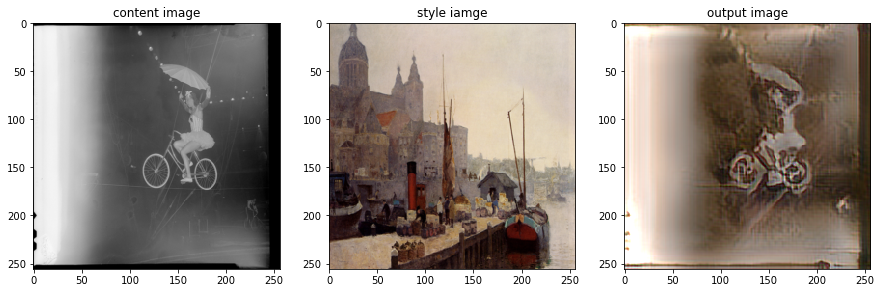

step 9000 ,time :  334
total loss : 1.649718e+05, content loss : 5.533804e+04, style loss : 1.096338e+05


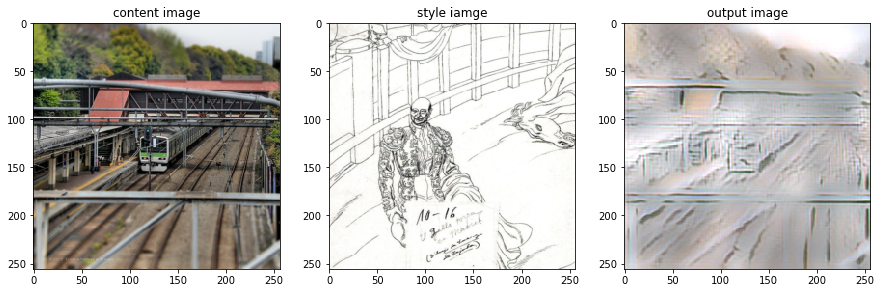

step 9500 ,time : 334.221
total loss : 1.341858e+05, content loss : 7.844185e+04, style loss : 5.574395e+04


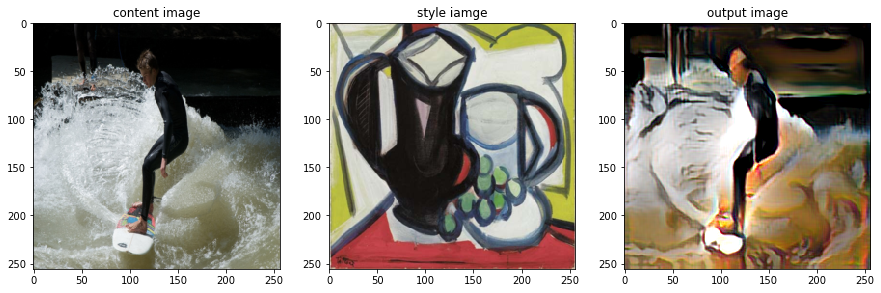

step 10000 ,time : 334.313
total loss : 6.465334e+04, content loss : 3.839944e+04, style loss : 2.625389e+04


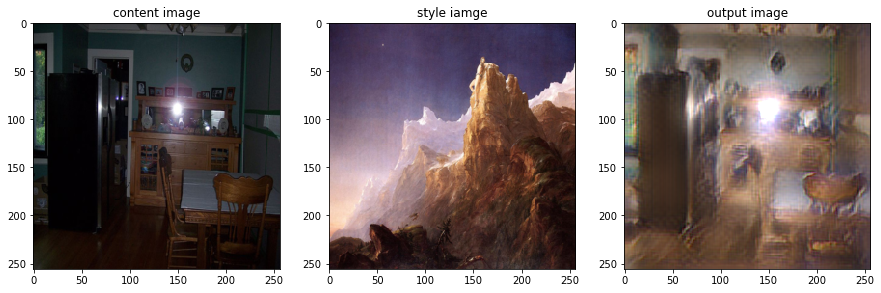

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 10500 ,time : 333.334
total loss : 6.825870e+04, content loss : 4.365450e+04, style loss : 2.460420e+04


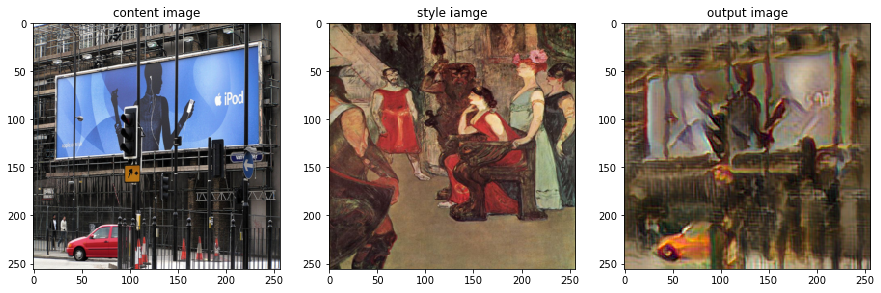

step 11000 ,time : 333.114
total loss : 5.258258e+04, content loss : 3.760384e+04, style loss : 1.497873e+04


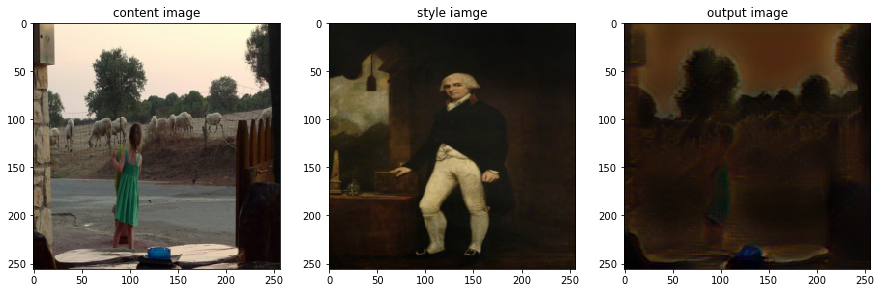

step 11500 ,time : 333.226
total loss : 8.589303e+04, content loss : 2.810150e+04, style loss : 5.779154e+04


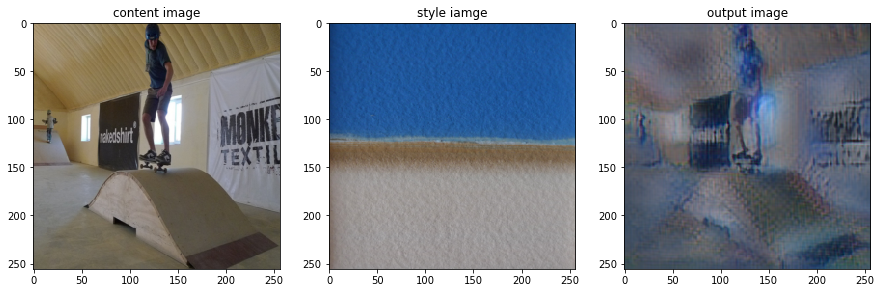

step 12000 ,time : 334.257
total loss : 1.077431e+05, content loss : 3.261590e+04, style loss : 7.512716e+04


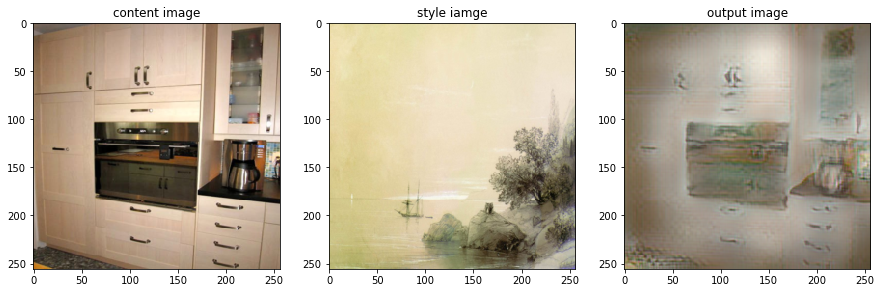

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 12500 ,time : 333.92
total loss : 3.950295e+04, content loss : 1.916017e+04, style loss : 2.034278e+04


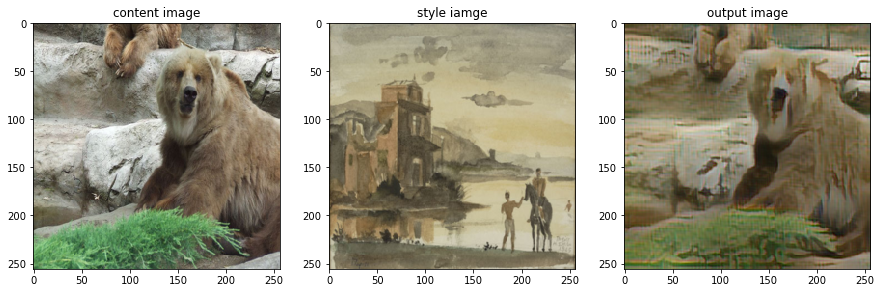

step 13000 ,time : 331.427
total loss : 6.569398e+04, content loss : 3.221277e+04, style loss : 3.348121e+04


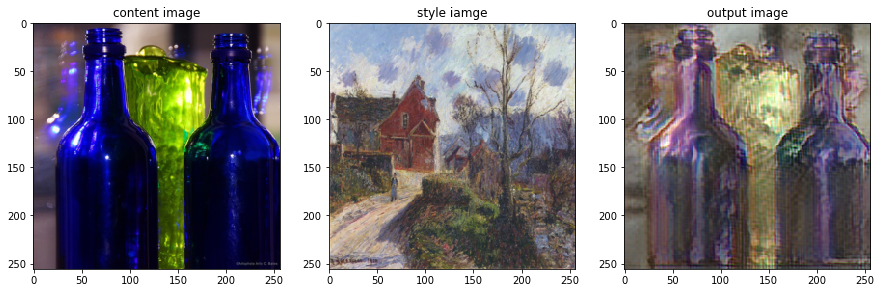

step 13500 ,time : 334.684
total loss : 8.197422e+04, content loss : 3.783023e+04, style loss : 4.414398e+04


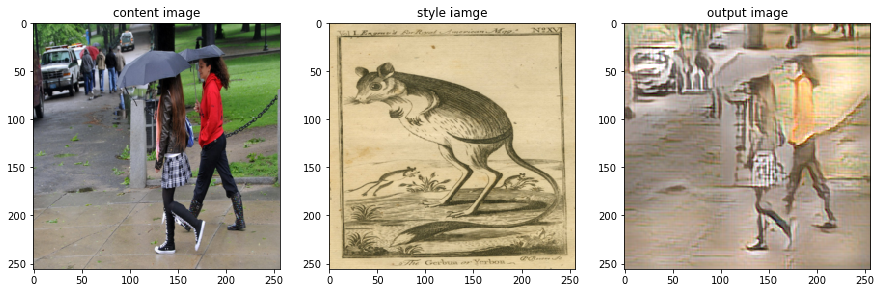

step 14000 ,time : 333.416
total loss : 6.098889e+04, content loss : 3.128206e+04, style loss : 2.970683e+04


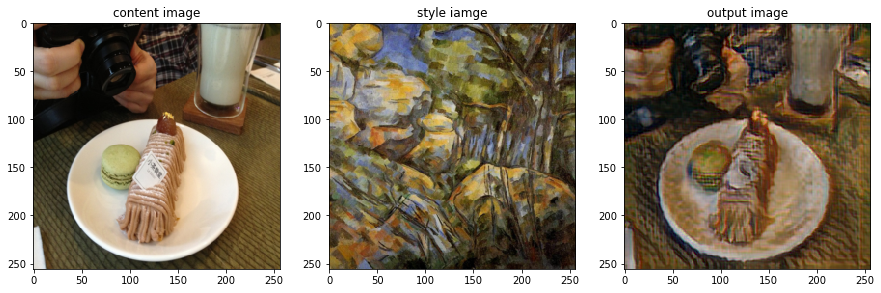

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 14500 ,time : 334.105
total loss : 6.235759e+04, content loss : 3.530029e+04, style loss : 2.705731e+04


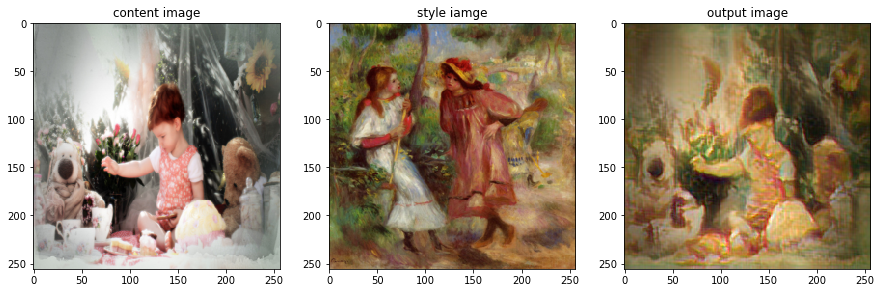

step 15000 ,time : 333.519
total loss : 6.844655e+04, content loss : 3.644594e+04, style loss : 3.200061e+04


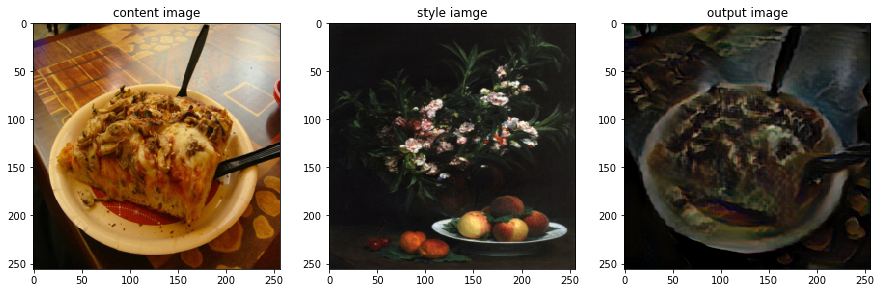

step 15500 ,time : 332.452
total loss : 1.378504e+05, content loss : 6.851957e+04, style loss : 6.933085e+04


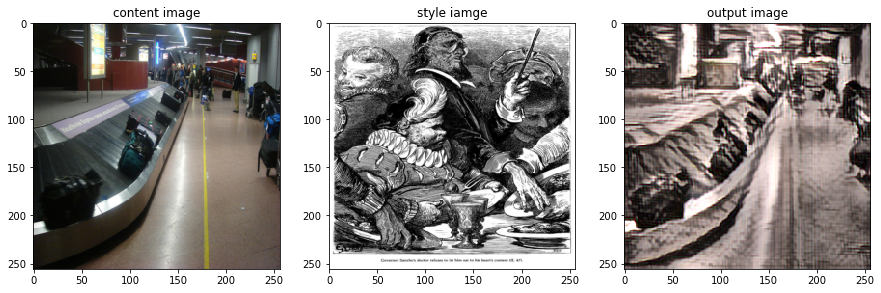

step 16000 ,time : 334.215
total loss : 1.240273e+05, content loss : 7.551485e+04, style loss : 4.851241e+04


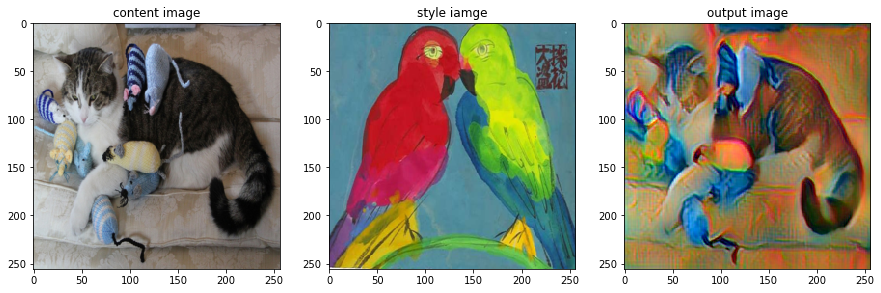

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 16500 ,time : 332.837
total loss : 5.358524e+04, content loss : 3.417727e+04, style loss : 1.940797e+04


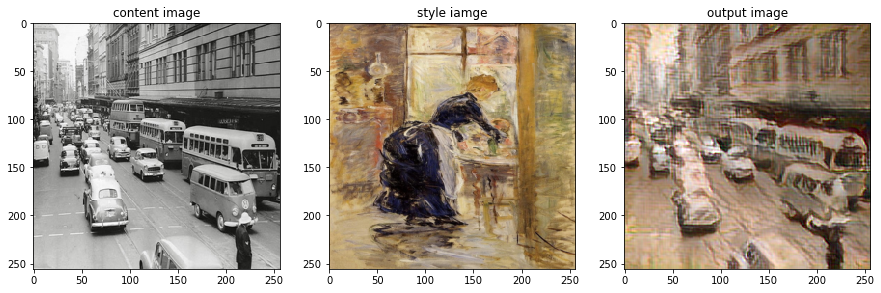

step 17000 ,time : 332.028
total loss : 9.593944e+04, content loss : 3.675197e+04, style loss : 5.918747e+04


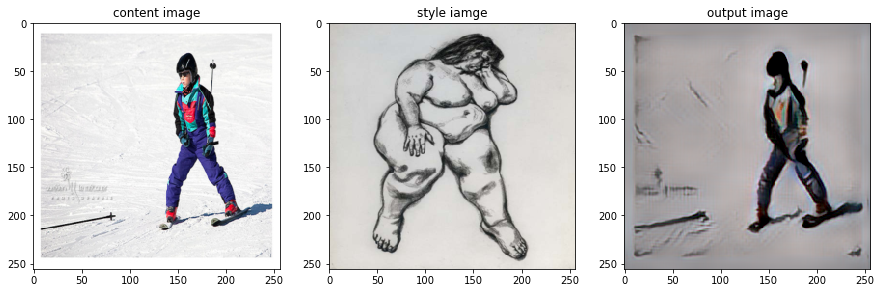

step 17500 ,time : 334.438
total loss : 1.038882e+05, content loss : 3.301868e+04, style loss : 7.086952e+04


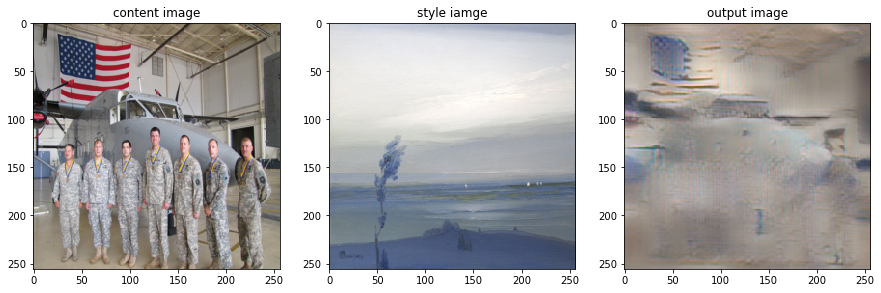

step 18000 ,time : 332.574
total loss : 1.251427e+05, content loss : 6.259498e+04, style loss : 6.254767e+04


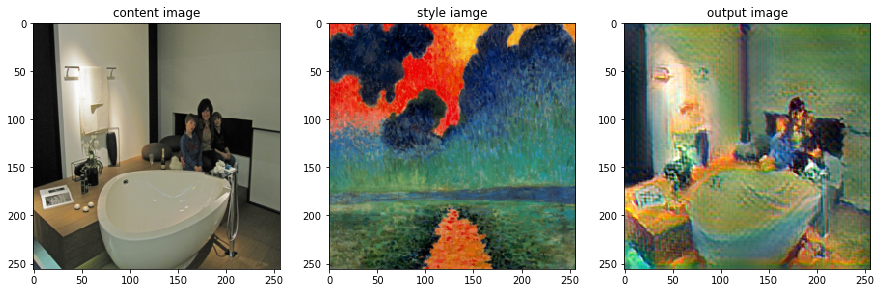

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 18500 ,time : 336.051
total loss : 2.294572e+05, content loss : 4.366443e+04, style loss : 1.857928e+05


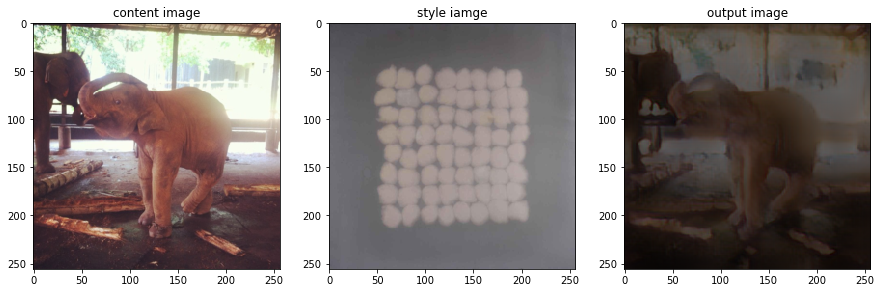

step 19000 ,time : 336.515
total loss : 1.552698e+05, content loss : 8.893654e+04, style loss : 6.633327e+04


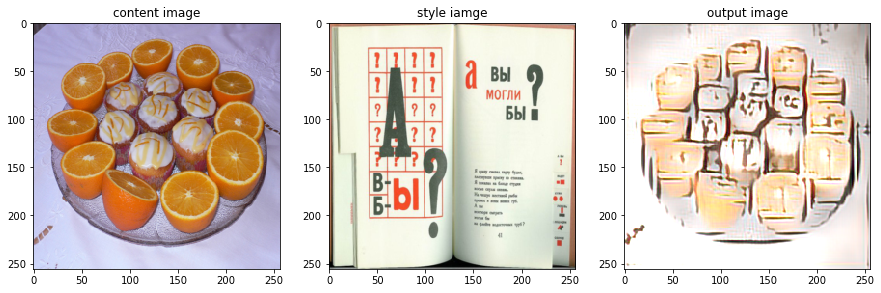

step 19500 ,time : 332.835
total loss : 2.116271e+05, content loss : 1.130764e+05, style loss : 9.855068e+04


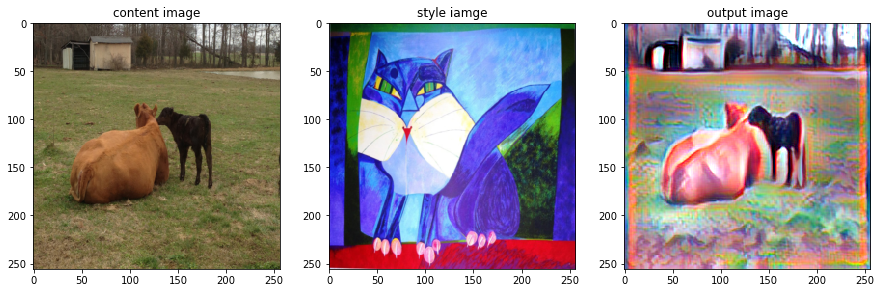

step 20000 ,time : 334.395
total loss : 7.095495e+04, content loss : 4.068944e+04, style loss : 3.026551e+04


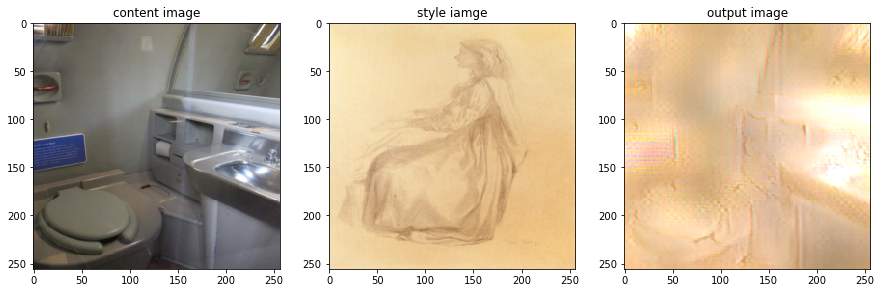

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 20500 ,time : 337.218
total loss : 1.117617e+05, content loss : 3.257743e+04, style loss : 7.918425e+04


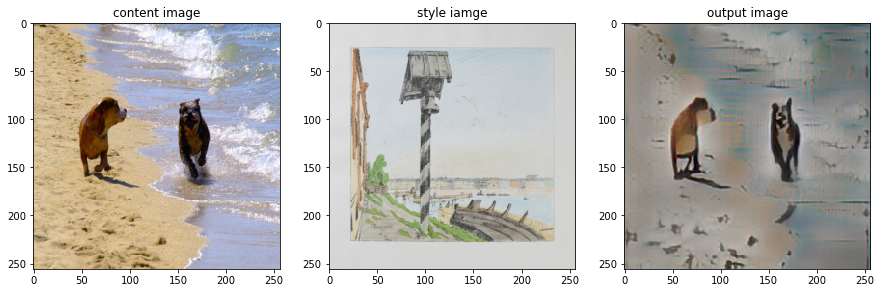

step 21000 ,time : 337.569
total loss : 4.745079e+04, content loss : 2.729868e+04, style loss : 2.015211e+04


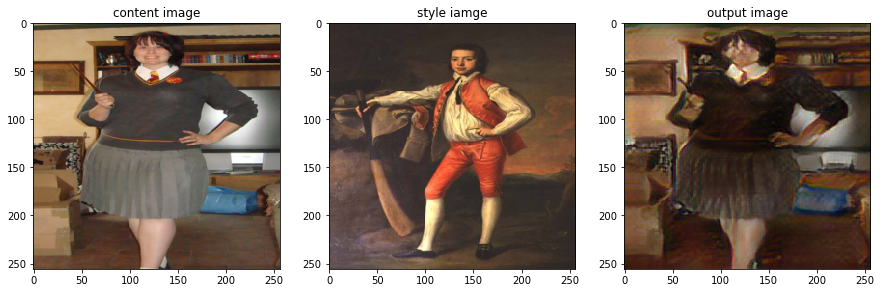

step 21500 ,time : 338.752
total loss : 9.402841e+04, content loss : 5.410643e+04, style loss : 3.992198e+04


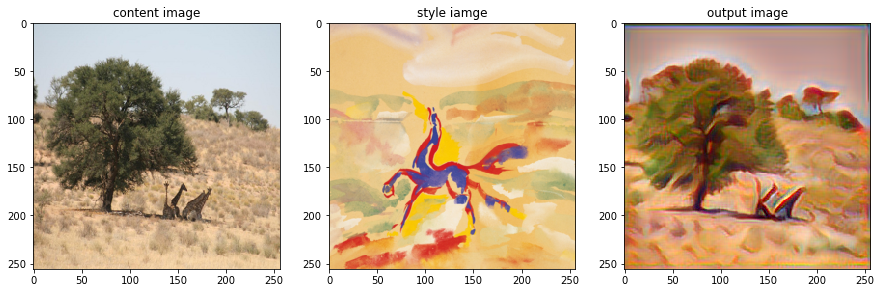

step 22000 ,time : 338.277
total loss : 6.105620e+04, content loss : 3.603804e+04, style loss : 2.501816e+04


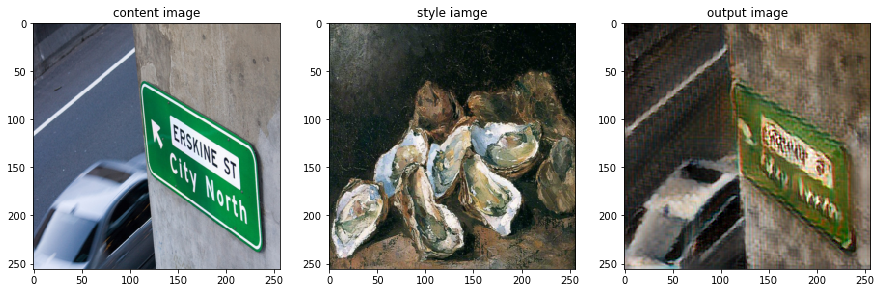

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 22500 ,time : 338.542
total loss : 1.242209e+05, content loss : 5.749277e+04, style loss : 6.672812e+04


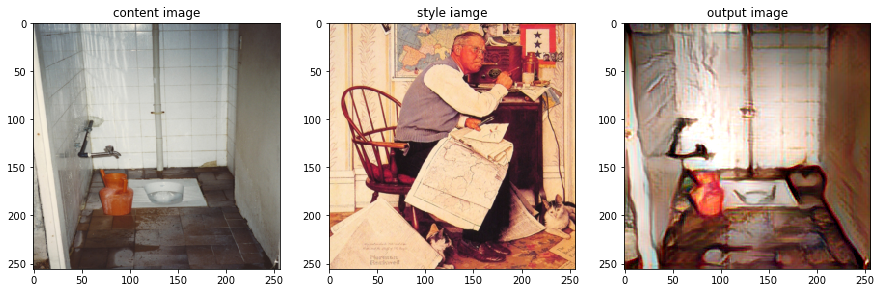

step 23000 ,time : 341.758
total loss : 5.502770e+04, content loss : 3.387003e+04, style loss : 2.115767e+04


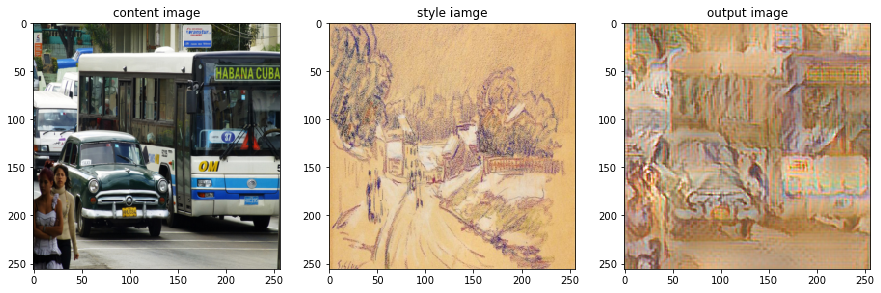

step 23500 ,time : 338.017
total loss : 7.163730e+04, content loss : 4.083365e+04, style loss : 3.080365e+04


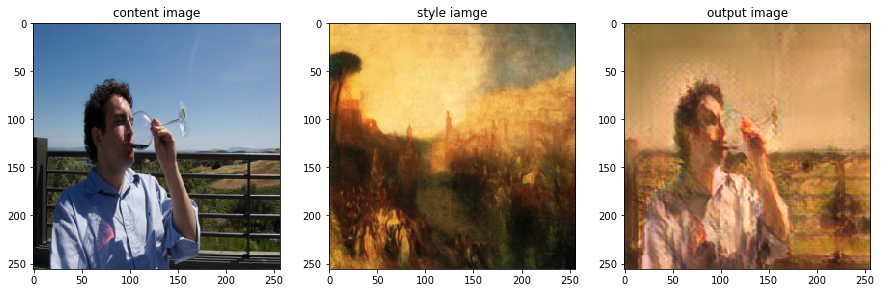

step 24000 ,time : 335.58
total loss : 9.170888e+04, content loss : 5.442099e+04, style loss : 3.728788e+04


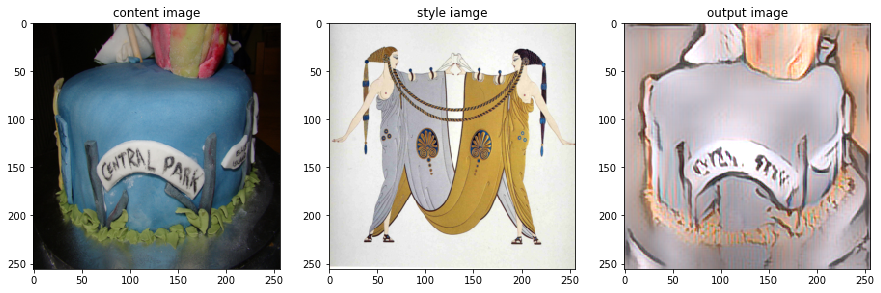

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 24500 ,time : 338.225
total loss : 1.443063e+05, content loss : 6.975630e+04, style loss : 7.454999e+04


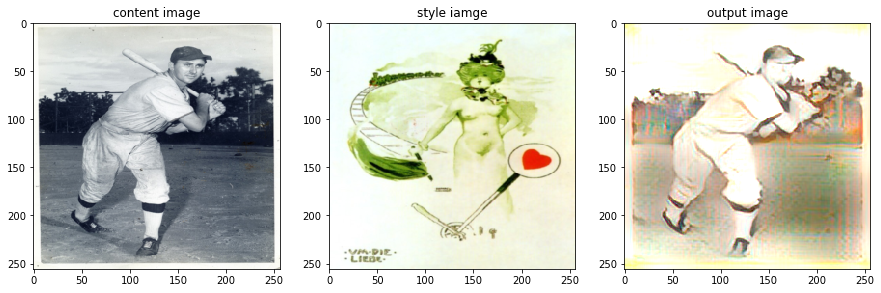

step 25000 ,time : 337.185
total loss : 1.526787e+05, content loss : 9.202756e+04, style loss : 6.065112e+04


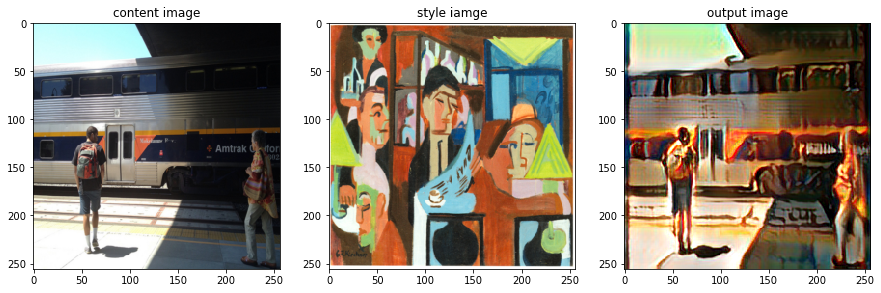

step 25500 ,time : 339.578
total loss : 9.464181e+04, content loss : 5.282046e+04, style loss : 4.182136e+04


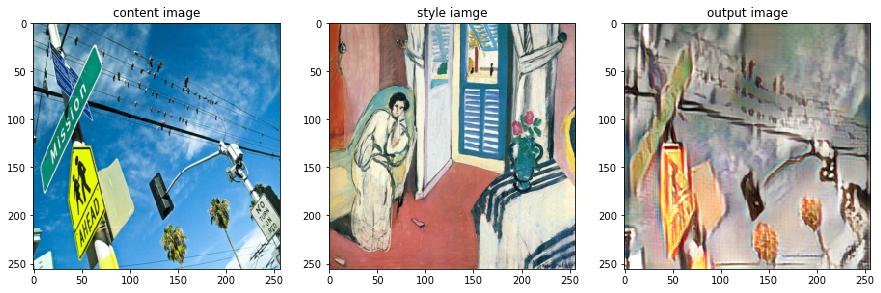

step 26000 ,time : 335.281
total loss : 5.539427e+04, content loss : 3.242452e+04, style loss : 2.296976e+04


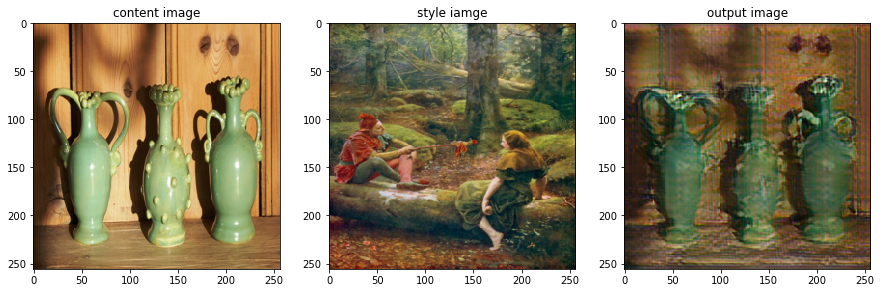

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 26500 ,time : 342.339
total loss : 6.019888e+04, content loss : 4.009093e+04, style loss : 2.010795e+04


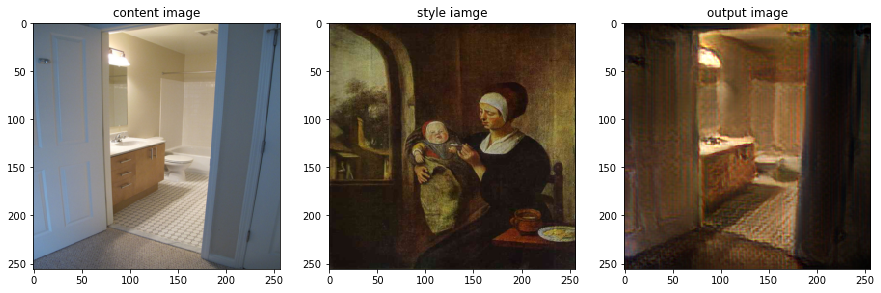

step 27000 ,time : 337.746
total loss : 1.140799e+05, content loss : 6.298920e+04, style loss : 5.109071e+04


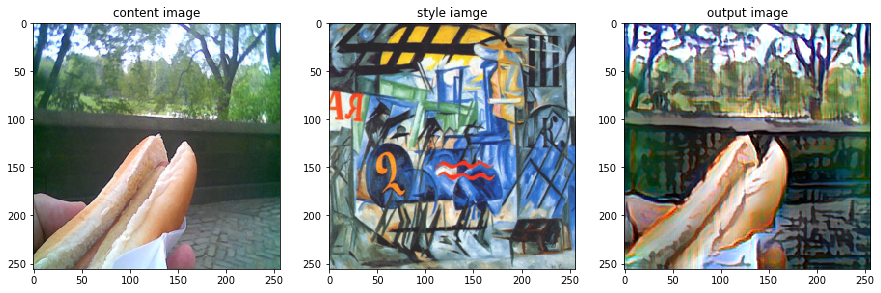

step 27500 ,time : 338.837
total loss : 1.220436e+05, content loss : 5.905275e+04, style loss : 6.299082e+04


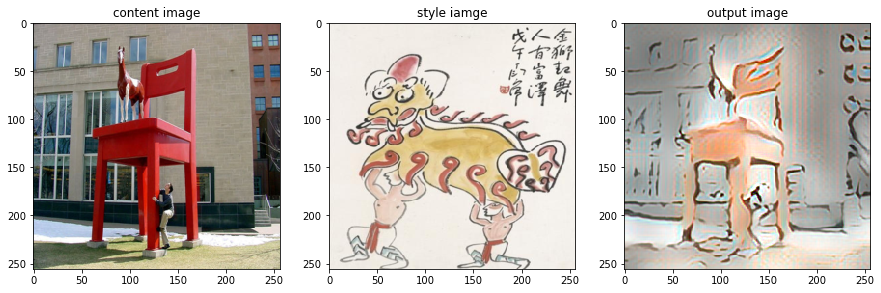

step 28000 ,time : 339.956
total loss : 9.971648e+04, content loss : 5.776259e+04, style loss : 4.195389e+04


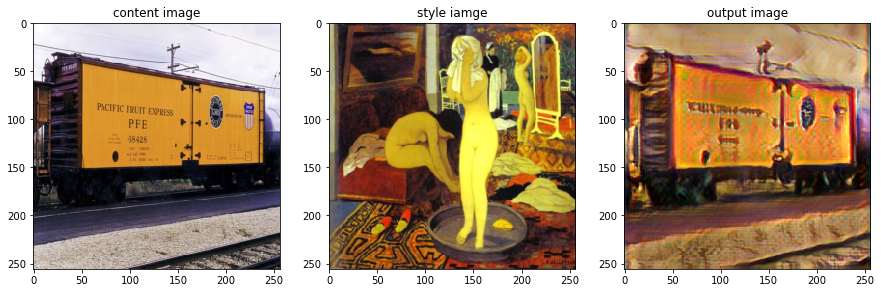

------------------------------ Model saved in file :  v3_model.ckpt ------------------------------
step 28500 ,time : 337.896
total loss : 6.854258e+04, content loss : 3.807487e+04, style loss : 3.046771e+04


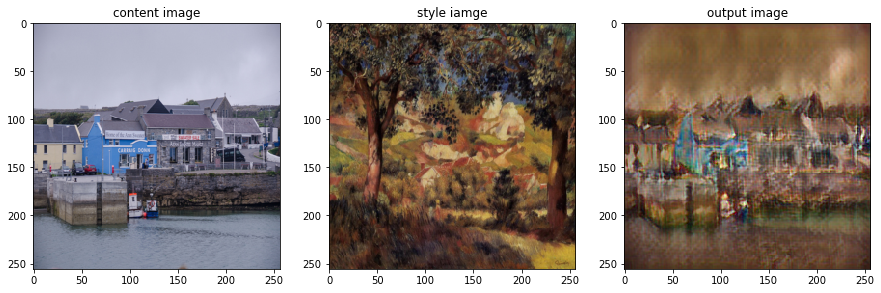

step 29000 ,time : 336.487
total loss : 4.053830e+04, content loss : 2.764747e+04, style loss : 1.289083e+04


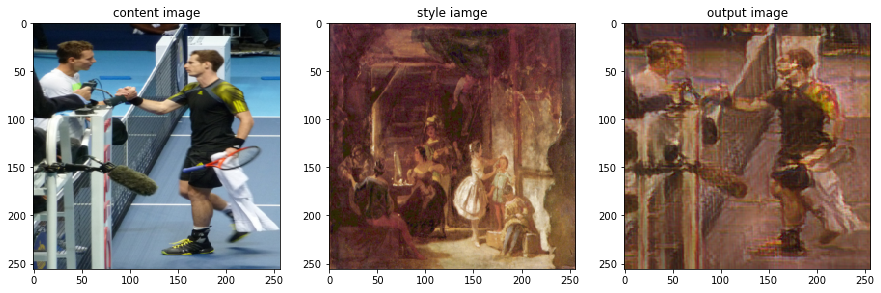

step 29500 ,time : 338.504
total loss : 5.680631e+04, content loss : 2.986148e+04, style loss : 2.694483e+04


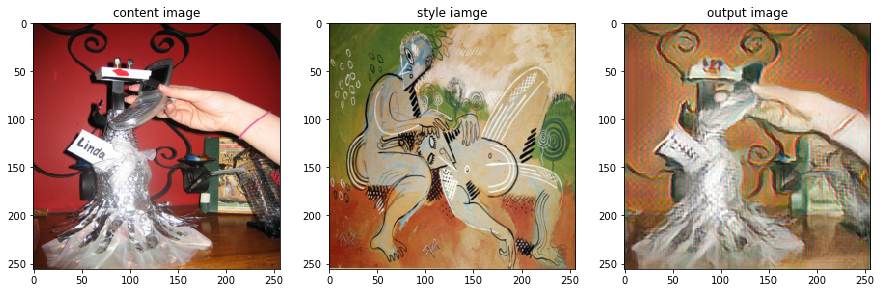

In [11]:

sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
saver = tf.train.Saver()

# # load saved model and retraining
# sess = tf.InteractiveSession()
# saver = tf.train.Saver()
# saver.restore(sess, 'v3_model.ckpt')

# training
for epo in range(EPOCH):
    img_list = os.listdir(COCO_PATH)
    img_list = img_list[:DATA_NUM]
    step = 0 
    t1 = time.time()
    while img_list:
        # make batch images
        img_names = [img_list.pop() for _ in range(BATCH_SIZE)] # get image names
        batch_imgs = [read_img(COCO_PATH+img_name) for img_name in img_names] # read imges : H,W,C
        batch_imgs = np.stack([batch_imgs[i] for i in range(BATCH_SIZE)]) # stack, list to array :  B, H, W, C

        # select style image
        ind = np.random.randint(0, STYLE_NUM)
        sty_img = read_img(STYLE_PATH+'/'+STYLE_NAME_LIST[ind])
        sty_img = np.expand_dims(sty_img, axis=0)

        if step%CHECK_POINT ==0:
            t2 = time.time()
            print('step %d ,time : %4g'%(step,t2-t1))
            t1 = t2
            t_loss,c_loss,s_loss,tout = sess.run([total_loss, cont_loss, sty_loss,generated_img], {content_images:batch_imgs, style_images:sty_img})
            print('total loss : %e, content loss : %e, style loss : %e'%(t_loss, c_loss, s_loss))

            plt.figure(figsize=(15,15))
            plt.subplot(131)
            plt.title('content image')
            plt.imshow(visualize_img(batch_imgs[0,:,:,:]))

            plt.subplot(132)
            plt.title('style iamge')
            plt.imshow(visualize_img(sty_img[0,:,:,:]))

            plt.subplot(133)
            plt.title('output image')
            plt.imshow(visualize_img(tout[0,:,:,:]))
            
           
            plt.show()
        if step%2000 == 0:
            save_path = saver.save(sess, 'v3_model.ckpt')
            print('-'*30, "Model saved in file : ", save_path,'-'*30)

        step += 1
        sess.run(train_step, {content_images:batch_imgs, style_images:sty_img})

#  스타일 테스트

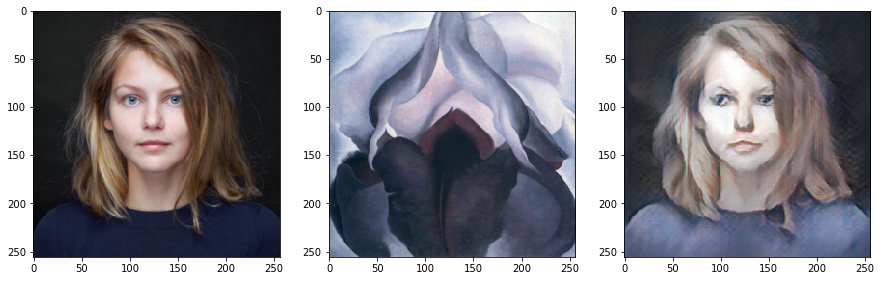

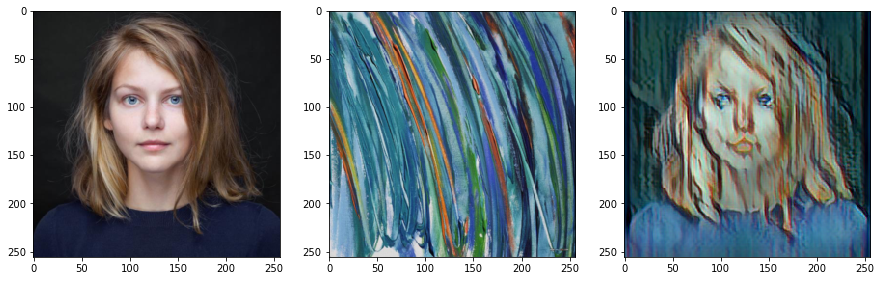

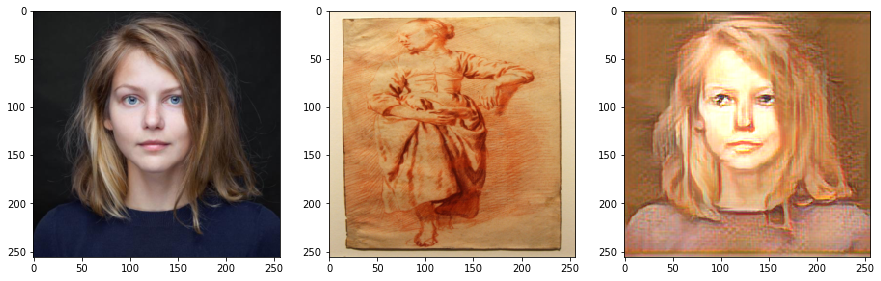

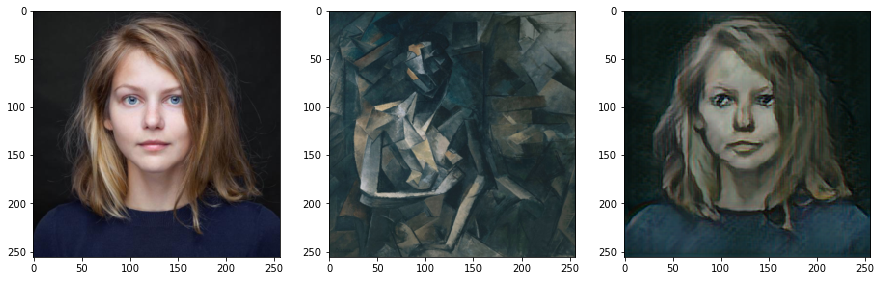

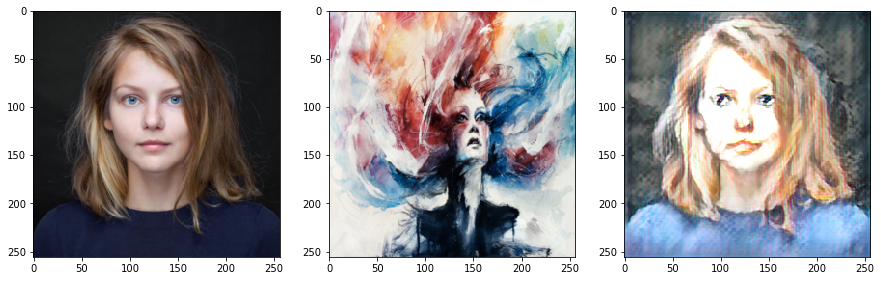

...

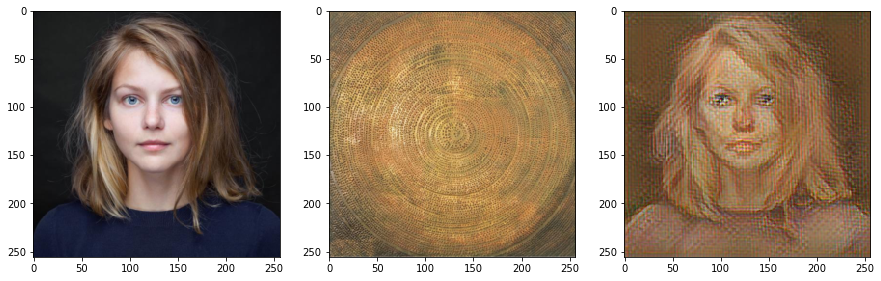

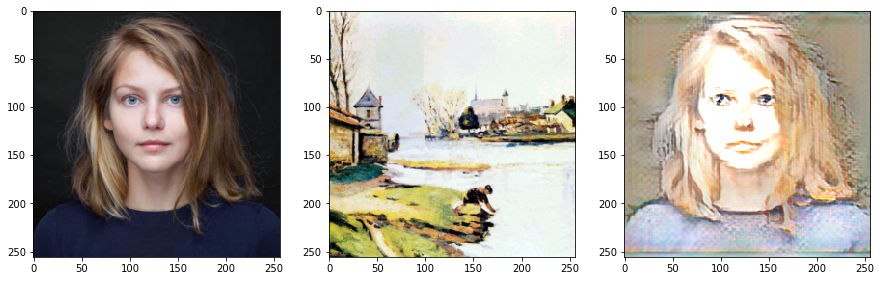

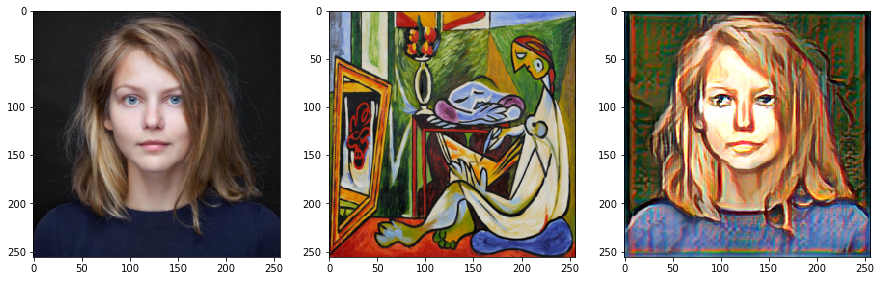

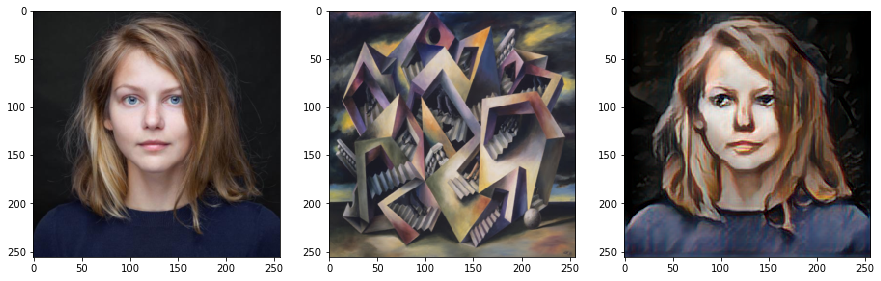

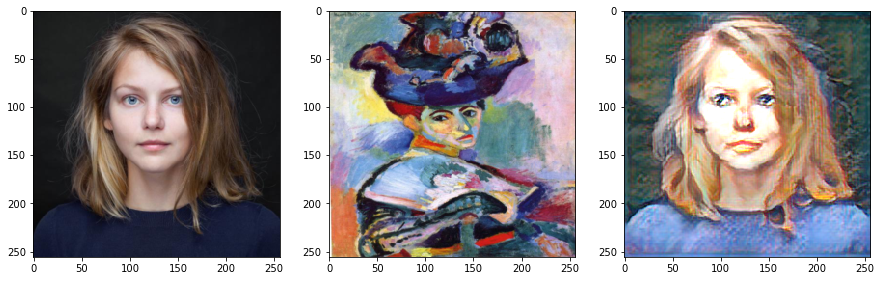

In [12]:
style_path = "style_images"
test_img_lst = os.listdir(style_path)
for test_img in test_img_lst:
    t_path = style_path+'/'+test_img
    test_sty = read_img(t_path)
    
    plt.figure(figsize=(15,15))
    test_img = read_img('content_images/karya.jpg')
    plt.subplot(131)
    plt.imshow(test_img)
    test_img = np.expand_dims(test_img, axis=0)



    plt.subplot(132)
    plt.imshow(test_sty)
    test_sty = np.expand_dims(test_sty, axis=0)
    

    test_out = sess.run(generated_img, {content_images:test_img, style_images:test_sty})
    plt.subplot(133)
    plt.imshow(visualize_img(test_out[0,:,:,:]))
    plt.show()